# Setup

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

## package dependencies

In [ ]:
!pip install kaggle

In [2]:
import json

add fastai library to the path

In [3]:
import sys
sys.path.append("/home/ubuntu/fastai/")

In [4]:
import fastai
from fastai.imports import *
from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *

In [5]:
%matplotlib inline

- generate api key from kaggle
- replace the kaggle_token with json 

# Kaggle Setup

- generate api key from [Kaggle](https://www.kaggle.com)
- click "My Account" -> "Create New Api Token"
- replace the cell below with json

In [ ]:
kaggle_token="""
{"username":"npatta01","key":"fdb61255c18946aa1b04763a86f7e7fd"}
"""

save kaggle_token to correct place

In [ ]:
!mkdir -p /home/ubuntu/.kaggle
!echo {json.dumps(kaggle_token)} > /home/ubuntu/.kaggle/kaggle.json
!chmod 600 /home/ubuntu/.kaggle/kaggle.json

download the dog breed dataset from kaggle     

(if the below line hangs, run it from the terminal)

In [ ]:
!kaggle competitions download -c dog-breed-identification

lets look at the files downloaded: 
- train.zip : dog images that we know the breed off
- labels.csv.zip : for each training dog image, what type of breed it is 
- test.zip  : dog images that we don't know the breed off

- sample_submission.csv.zip : what a sample submission to kaggle looks like


In [ ]:
!ls ~/.kaggle/competitions/dog-breed-identification

In [ ]:
!ls ~/.kaggle/competitions/dog-breed-identification/*.zip

In [6]:
PATH = "/home/ubuntu/.kaggle/competitions/dog-breed-identification"

unzip all the files

In [ ]:
!unzip -o {PATH}/labels.csv.zip -d {PATH}
!unzip -o {PATH}/sample_submission.csv.zip -d {PATH}
!unzip -o {PATH}/test.zip -d {PATH}
!unzip -o {PATH}/train.zip -d {PATH}

verify folders are located here

In [ ]:
!ls {PATH}

# Explore data

read the labels csv    
look at the first 5 lines of the file

In [7]:
labels_df = pd.read_csv(f'{PATH}/labels.csv')
labels_df.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


number of dog breeds

In [8]:
len(labels_df['breed'].unique())

120

Number of images per dog breed     
Each dog breed has atleast 60 images

In [9]:
labels_df.pivot_table(index='breed', aggfunc=len).sort_values('id', ascending=False)

,id
breed,
scottish_deerhound,126
maltese_dog,117
afghan_hound,116
entlebucher,115
bernese_mountain_dog,114
shih-tzu,112
great_pyrenees,111
pomeranian,111
basenji,110


helper function to display a single image or multiple images of a dog breed

In [10]:
def display_image(dog_breed=None,image_num=None, num_images = 10):
    if image_num is not None:
        record = labels_df.iloc[0]
        dog_breed = record["breed"]
        image_id = record["id"]
        image_path = f"{PATH}/train/{image_id}.jpg"
        print (f"Here is a {dog_breed}")
        img = PIL.Image.open(image_path);
        return img
    else:
        
        dog_breeds = labels_df[labels_df["breed"]==dog_breed].head(num_images).to_dict(orient='records')
        
        plt.figure(figsize=(50,30))
        plt.suptitle(f'{num_images} images of {dog_breed}', fontsize=16)

        columns = 5
        for i, record in enumerate(dog_breeds):
            
            image_id = record['id']
            image_path = f"{PATH}/train/{image_id}.jpg"
            image = PIL.Image.open(image_path)
            plt.subplot(len(dog_breeds) / columns + 1, columns, i + 1)
            plt.imshow(image)
            #plt.title(image_id)

In [11]:
labels_df.head(20).to_dict(orient='records')

[{'id': '000bec180eb18c7604dcecc8fe0dba07', 'breed': 'boston_bull'},
 {'id': '001513dfcb2ffafc82cccf4d8bbaba97', 'breed': 'dingo'},
 {'id': '001cdf01b096e06d78e9e5112d419397', 'breed': 'pekinese'},
 {'id': '00214f311d5d2247d5dfe4fe24b2303d', 'breed': 'bluetick'},
 {'id': '0021f9ceb3235effd7fcde7f7538ed62', 'breed': 'golden_retriever'},
 {'id': '002211c81b498ef88e1b40b9abf84e1d', 'breed': 'bedlington_terrier'},
 {'id': '00290d3e1fdd27226ba27a8ce248ce85', 'breed': 'bedlington_terrier'},
 {'id': '002a283a315af96eaea0e28e7163b21b', 'breed': 'borzoi'},
 {'id': '003df8b8a8b05244b1d920bb6cf451f9', 'breed': 'basenji'},
 {'id': '0042188c895a2f14ef64a918ed9c7b64', 'breed': 'scottish_deerhound'},
 {'id': '004396df1acd0f1247b740ca2b14616e', 'breed': 'shetland_sheepdog'},
 {'id': '0067dc3eab0b3c3ef0439477624d85d6', 'breed': 'walker_hound'},
 {'id': '00693b8bc2470375cc744a6391d397ec', 'breed': 'maltese_dog'},
 {'id': '006cc3ddb9dc1bd827479569fcdc52dc', 'breed': 'bluetick'},
 {'id': '0075dc49dab4024d

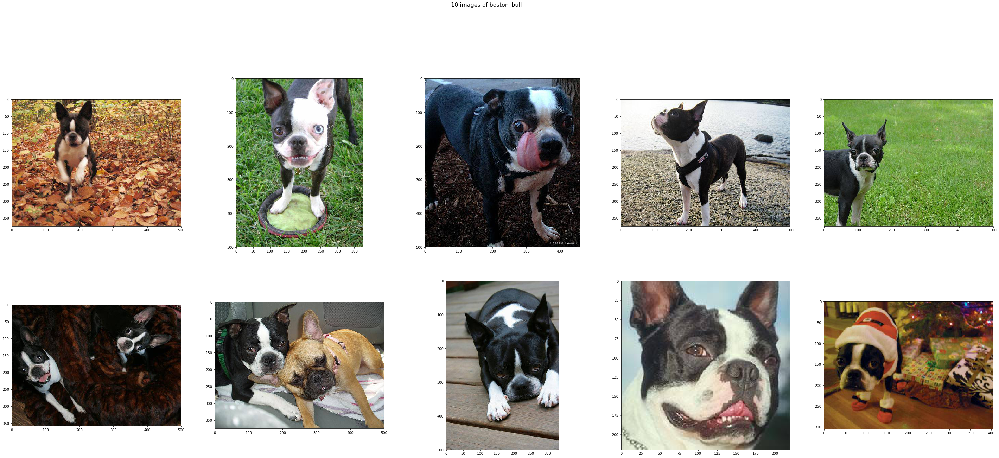

In [12]:
display_image(dog_breed="boston_bull")

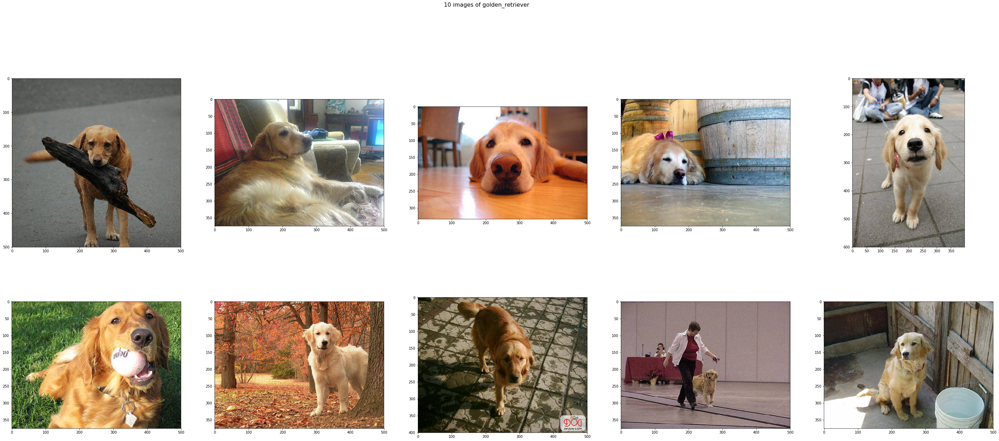

In [13]:
display_image(dog_breed="golden_retriever")

# Review

**Neural Nets vs Deep Neural Nets**
![Neural Nets vs Deep Neural Nets](https://i.stack.imgur.com/OH3gI.png "Neural Network")
Note the image on the left is not a Convolutional Neural Network (network used for images)




**Convolutional Neural Network**      
This is what a neural network used for images look like
![Transfer Learning](https://www.learnopencv.com/wp-content/uploads/2017/11/cnn-schema1-600x400.jpg)


**Transfer Learning**     
Deep learning requires a lot of data and time.   
One way to overcome that is to use a model that was trained on a similar task and fine tune it for your problem.

We will be using a model trained on Imagenet dataset (stingray, hen , hyena, milk can , safety pin, ...).   
Full list of  [classes](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a)

This works because the earlier layers of the network learned general feature.
![Learned features](https://i.stack.imgur.com/bN2iA.png)





# Modelling

download pretrained weights

In [ ]:
WEIGHTS_DIR="/home/ubuntu/fastai/fastai/"
!wget -P {WEIGHTS_DIR} http://files.fast.ai/models/weights.tgz
!tar -xvf {WEIGHTS_DIR}/weights.tgz -C {WEIGHTS_DIR}

In [23]:
PATH = "/home/ubuntu/.kaggle/competitions/dog-breed-identification/"
sz = 224 # size of image
arch = resnet34 #model architecture.. model has 101 layers
bs=128 # batch size; number of images to process at one time

generate a validation data set   


In [15]:
label_csv = f'{PATH}/labels.csv'
n = len(list(open(label_csv)))-1
val_idxs = get_cv_idxs(n)

creates a generator for our images 

to avoid overfiiting:
- we randomly zoom in
- random rotate image , change lighting, flip image

In [17]:
transforms_side_on

In [24]:
def get_data(sz, bs):
    tfms = tfms_from_model(arch, sz, aug_tfms=transforms_side_on,
                           max_zoom=1.1)
    data = ImageClassifierData.from_csv(PATH, 'train', 
               f'{PATH}labels.csv', test_name='test', num_workers=8,
               val_idxs=val_idxs, suffix='.jpg', tfms=tfms, bs=bs)
    #return data.resize(sz, 'tmp')
    return data if sz>300 else data.resize(340, 'tmp')



In [21]:
!rm -rf {PATH}/tmp

In [25]:
data = get_data(sz, bs)
learn = ConvLearner.pretrained(arch, data, precompute=True)
learn.fit(lrs=1e-2, n_cycle=3)


                                                      
100%|██████████| 81/81 [00:50<00:00,  1.59it/s]


epoch      trn_loss   val_loss   accuracy                 
    0      3.522826   1.954063   0.664873  
    1      2.063217   1.066309   0.772994                 
    2      1.36554    0.806871   0.806262                 



[array([0.80687]), 0.8062622298699769]

above 80% accuracy is pretty good

precompute = False  means use image date augmentation

Reminder: a epoch is one pass through the data, a cycle is how many epochs you said is in a cycle

In [26]:
learn.precompute = False
learn.fit(lrs=1e-2, n_cycle=5, cycle_len=1)

epoch      trn_loss   val_loss   accuracy                 
    0      1.053966   0.747632   0.818004  
    1      0.98326    0.697134   0.813112                  
    2      0.921237   0.660393   0.818982                  
    3      0.879976   0.628546   0.825342                  
    4      0.830033   0.605162   0.831213                  



[array([0.60516]), 0.8312133084071359]

# save and reload the layers

In [27]:
learn.save('224_pre')
learn.load('224_pre')

train on larger image size

Good way to avoid overfitting:       
Start training on small images for a few epochs     
Then switch to bigger images, and continuing training      

In [ ]:
#learn.set_data(get_data(299, bs))


In [ ]:
#learn.fit(lrs=1e-2, n_cycle=3, cycle_len=1)


If the validation loss is lower than the train loss, that means you are underfitting.
One culprit is cyclen=1; the cycle is too short

learning rate is getting reset before it had the chance to zoom in properly

If we increase cyclen, the first cycle So we will add cycle_mult=2 (i.e. 1st cycle is 1 epoch, 2nd cycle is 2 epochs, and 3rd cycle is 4 epochs)

In [20]:
#learn.fit(lrs=1e-2, n_cycle=3, cycle_len=1, cycle_mult=2)

# Accuracy

In [29]:
log_preds,y = learn.TTA()
preds = np.mean(np.exp(log_preds),axis=0)
(metrics.log_loss(y,preds), accuracy_np(preds,y))

(0.606105879227275, 0.8424657534246576)

In [30]:
predicted_class = np.argmax(preds, axis=1)
confidence = np.max(preds, axis=1)

In [31]:
predictions_df = pd.DataFrame ({'actual': y, 'pred': predicted_class,'image':learn.data.val_ds.fnames,'conf':confidence})

In [32]:
predictions_df['actual_class'] = predictions_df['actual'].apply(lambda x : data.classes[x])
predictions_df['pred_class'] = predictions_df['pred'].apply(lambda x : data.classes[x])

In [33]:
predictions_df.head()

,actual,pred,image,conf,actual_class,pred_class
0,19,19,train/000bec180eb18c7604dcecc8fe0dba07.jpg,0.942098,boston_bull,boston_bull
1,15,15,train/00214f311d5d2247d5dfe4fe24b2303d.jpg,0.861031,bluetick,bluetick
2,7,7,train/003df8b8a8b05244b1d920bb6cf451f9.jpg,0.448381,basenji,basenji
3,99,99,train/004396df1acd0f1247b740ca2b14616e.jpg,0.607343,shetland_sheepdog,shetland_sheepdog
4,73,73,train/00693b8bc2470375cc744a6391d397ec.jpg,0.890876,maltese_dog,maltese_dog


make the prediction for the first image

In [41]:
image_path = PATH+predictions_df['image'].iloc[0]
trn_tfms, val_tfms = tfms_from_model(arch, sz)
im = val_tfms(np.array(open_image(image_path)))

image_pred = np.exp(learn.predict_array(im[None]))
image_pred

array([[0.00011, 0.00002, 0.00011, 0.     , 0.00001, 0.00001, 0.     , 0.00001, 0.0001 , 0.00001, 0.00003,
        0.00004, 0.00001, 0.00012, 0.00001, 0.00002, 0.00001, 0.00001, 0.     , 0.96991, 0.00001, 0.00017,
        0.00028, 0.     , 0.00001, 0.00005, 0.00007, 0.00103, 0.     , 0.00049, 0.     , 0.00002, 0.00014,
        0.00002, 0.     , 0.00002, 0.     , 0.     , 0.00001, 0.     , 0.00002, 0.00166, 0.00002, 0.00001,
        0.     , 0.01961, 0.     , 0.     , 0.00002, 0.     , 0.00002, 0.00002, 0.     , 0.00036, 0.00002,
        0.00001, 0.00001, 0.     , 0.00007, 0.     , 0.00003, 0.00059, 0.00001, 0.00001, 0.00001, 0.00001,
        0.     , 0.     , 0.     , 0.     , 0.00008, 0.00001, 0.00002, 0.00002, 0.00025, 0.00007, 0.00008,
        0.00003, 0.     , 0.00001, 0.00003, 0.     , 0.00002, 0.     , 0.00006, 0.00011, 0.00002, 0.     ,
        0.00167, 0.00001, 0.     , 0.     , 0.00011, 0.     , 0.     , 0.     , 0.00014, 0.     , 0.00001,
        0.00001, 0.00046, 0.     , 0.

In [46]:
np.max(image_pred)

0.9699101

In [68]:
from urllib import request
f = open('00000001.jpg', 'wb')
f.write(request.urlopen("http://www.gunnerkrigg.com/comics/00000001.jpg").read())
f.close()

In [69]:
!ls 00000001.jpg

00000001.jpg


In [ ]:
"http://www.gunnerkrigg.com/comics/00000001.jpg"

In [76]:
!ls  tmp.jpg

tmp.jpg


In [71]:
def predict_class_web(url,ext="jpg"):
    file_name = f'tmp.{ext}'
    f = open(file_name, 'wb')
    f.write(request.urlopen(url).read())
    f.close()
    
    return predict_class(file_name)


In [47]:
def predict_class(image_path):
    trn_tfms, val_tfms = tfms_from_model(arch, sz)
    im = val_tfms(np.array(open_image(image_path)))

    preds = learn.predict_array(im[None])
    class_idx = np.argmax(preds)
    print(data.classes[class_idx],np.max(image_pred))
    
    img = PIL.Image.open(image_path);
    return img
    
    #return preds
    #return np.argmax(preds)

boston_bull 0.9699101


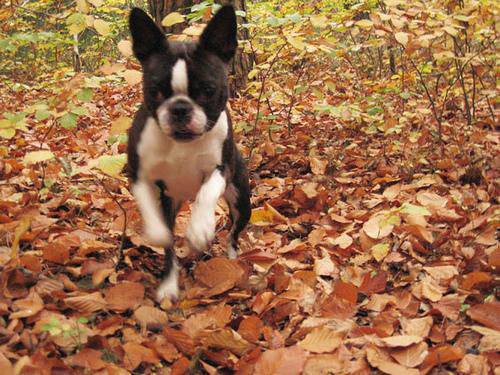

In [48]:
predict_class(image_path)

boxer 0.9699101


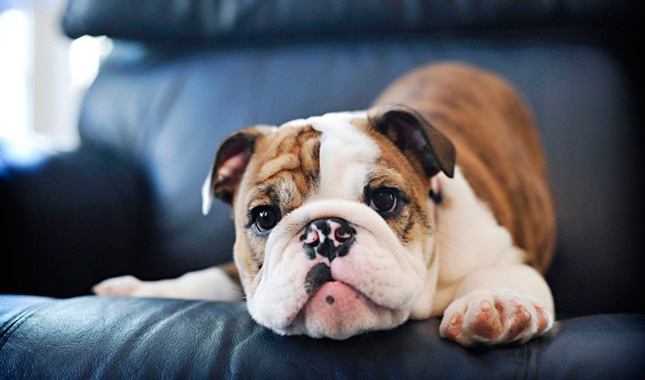

In [78]:
predict_class_web("https://vetstreet.brightspotcdn.com/dims4/default/3407f3b/2147483647/thumbnail/645x380/quality/90/?url=https%3A%2F%2Fvetstreet-brightspot.s3.amazonaws.com%2Ffb%2F31%2F032a6aae436a9821acda211044fb%2Fbulldog-ap-rn4myi-645.jpg")

In [49]:
imr = ImageModelResults(data.val_ds,np.mean(np.exp(log_preds),axis=0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


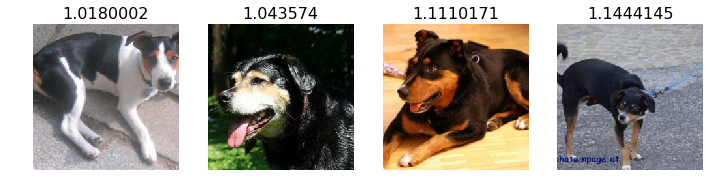

In [50]:
imr.plot_most_incorrect(5)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


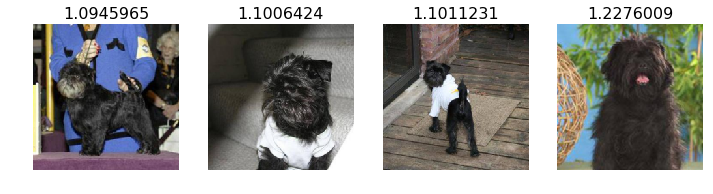

In [51]:
imr.plot_most_uncertain(0)

# Confusion Matrix

In [52]:
breeds = learn.data.classes
cm = confusion_matrix(predictions_df['actual'], predictions_df['pred'])


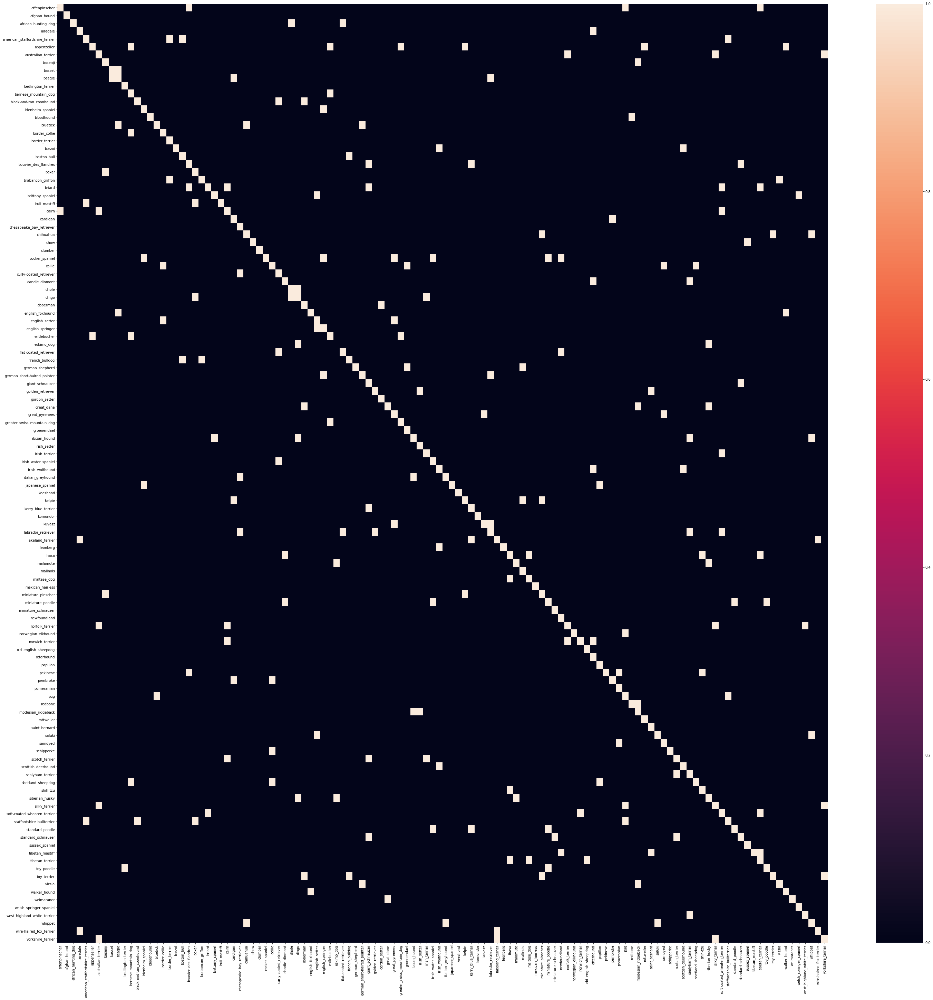

In [53]:
fig, ax = plt.subplots(figsize=(50, 50))
_ = sns.heatmap(cm, ax=ax, yticklabels=breeds, xticklabels=breeds, robust=True)

# Similar Images

## dhole vs dingo

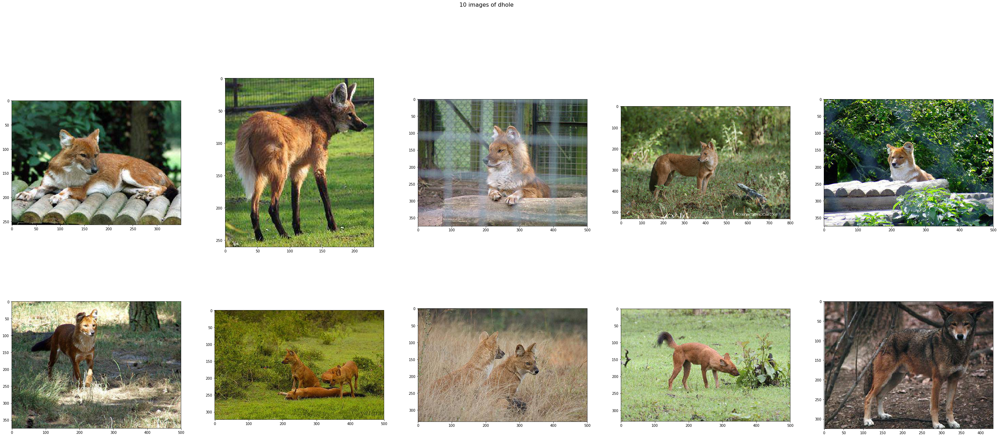

In [54]:
display_image(dog_breed="dhole")

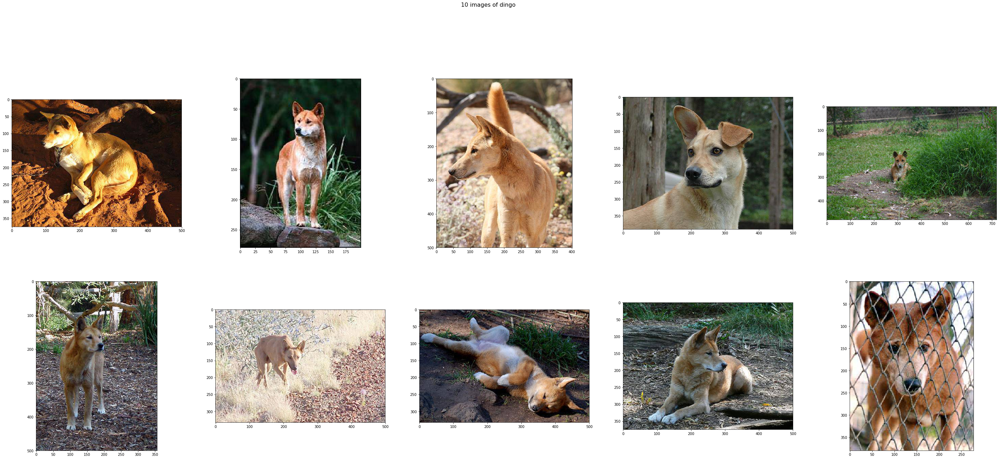

In [55]:
display_image(dog_breed="dingo")

## basset vs beagle

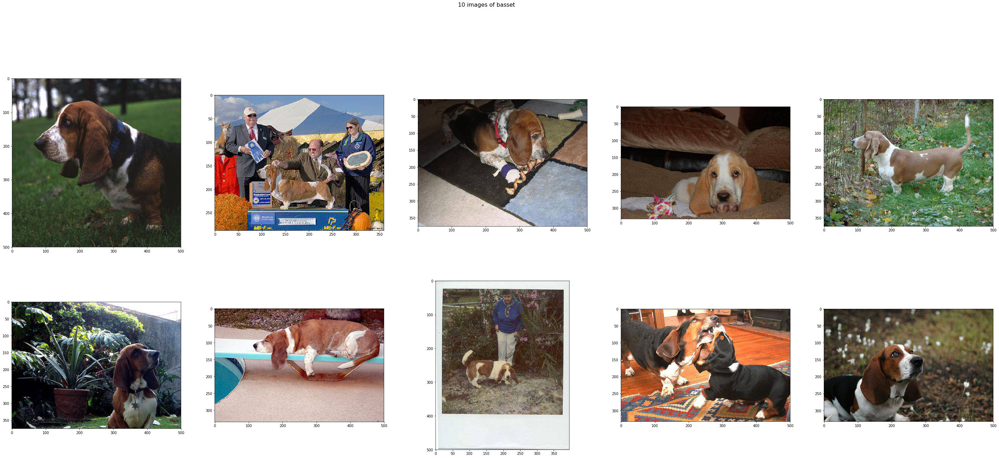

In [56]:
display_image(dog_breed="basset")

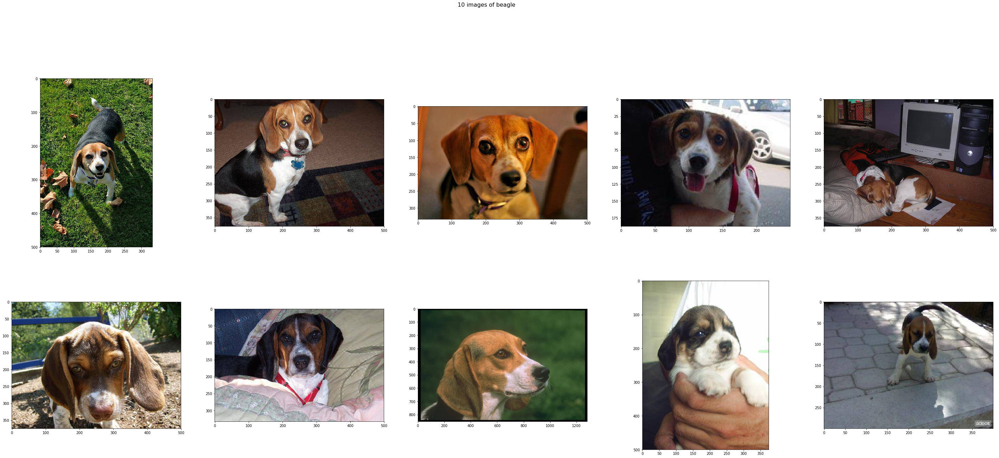

In [57]:
display_image(dog_breed="beagle")

# Test Dataset

make prediction on test data

In [58]:
log_preds , y = learn.TTA(is_test = True)
probs = np.exp(log_preds)
preds = np.mean(probs,axis=0)


In [59]:
df = pd.DataFrame(preds)
df.columns = data.classes

In [60]:
df.insert(0, 'id' , [o[5:-4] for o in data.test_ds.fnames])

In [61]:
df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,f11d3e75389720c45f2c0001c131ba21,0.000022,0.000090,0.000079,0.000035,0.000178,0.699503,0.000041,0.003098,0.000454,...,0.000020,0.000119,0.000042,0.000762,0.000072,0.000484,0.000012,0.000275,0.000184,0.000046
1,ba56fca86fb9d3d97d41ef4d3b750e5e,0.000039,0.000622,0.000143,0.000054,0.000121,0.000441,0.000026,0.000336,0.000585,...,0.002584,0.000079,0.000754,0.000260,0.000891,0.000146,0.000199,0.002909,0.000078,0.000017
2,198e2b278564ef250a5a332ffd1b6189,0.000504,0.000114,0.001868,0.000595,0.005912,0.002879,0.000175,0.000306,0.000284,...,0.000696,0.001654,0.001068,0.000769,0.003229,0.000751,0.001394,0.000806,0.000278,0.000151
3,75f8a13ae05b56eed204a33bf99287ed,0.000055,0.000181,0.000122,0.000683,0.000077,0.002821,0.000751,0.000544,0.000724,...,0.000100,0.006165,0.001824,0.000428,0.000328,0.000043,0.000031,0.000155,0.000051,0.000520
4,98e74b6d16170bd61e7cc04bf8af49c5,0.000012,0.000012,0.000072,0.000039,0.000865,0.000006,0.000033,0.000097,0.000010,...,0.000041,0.000049,0.000119,0.000013,0.002640,0.000012,0.000046,0.000146,0.000025,0.000031


In [62]:
SUBM = f'{PATH}subm/'
os.makedirs(SUBM,exist_ok=True)
submission_name = f'resenet32_subm.gz'
df.to_csv(submission_name, compression='gzip',index=False)

In [79]:
FileLink(submission_name)

/home/ubuntu/fastai_cnn/resenet32_subm.gz

In [63]:
learn.summary()

OrderedDict([('Conv2d-1',
              OrderedDict([('input_shape', [-1, 3, 224, 224]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('trainable', False),
                           ('nb_params', 9408)])),
             ('BatchNorm2d-2',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('trainable', False),
                           ('nb_params', 128)])),
             ('ReLU-3',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 112, 112]),
                           ('nb_params', 0)])),
             ('MaxPool2d-4',
              OrderedDict([('input_shape', [-1, 64, 112, 112]),
                           ('output_shape', [-1, 64, 56, 56]),
                           ('nb_params', 0)])),
             ('Conv2d-5',
              OrderedDict([('input_shape', [-1, 64, 56, 

In [64]:
# How good are results

In [65]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
plt.style.use('ggplot')


In [ ]:
## done 

In [66]:
FileLink(submission_name)

/home/ubuntu/fastai_cnn/resenet32_subm.gz

In [67]:
df.insert(0, 'id' , [o[5:-4] for o in data.test_ds.fnames])

ValueError: cannot insert id, already exists

In [ ]:
df.head()

In [ ]:
SUBM = f'{PATH}subm/'
os.makedirs(SUBM,exist_ok=True)
df.to_csv(f'/notebooks/courses/dl1/custom/subm.gz', compression='gzip',index=False)

In [ ]:
!pwd

In [ ]:
FileLink(f'/notebooks/courses/dl1/custom/subm.gz')

In [ ]:
!ls {SUBM}subm.gz

In [ ]:
#  Large Model